<a href="https://colab.research.google.com/github/yuvipaloozie/Data-Driven-Swing-Trading/blob/main/SwingTradingPortfolio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install yfinance ta plotly quantstats pyportfolioopt xgboost fredapi
!rm -rf /root/.cache/matplotlib

import yfinance as yf
import pandas as pd
import numpy as np
import ta
import xgboost as xgb
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import quantstats as qs
from IPython.display import HTML, display

from fredapi import Fred

from pypfopt import EfficientFrontier, risk_models, expected_returns
from pypfopt import plotting as pypfopt_plotting


from sklearn.model_selection import TimeSeriesSplit
from sklearn.preprocessing import StandardScaler

from dateutil.relativedelta import relativedelta
import warnings

warnings.filterwarnings('ignore')
pd.options.mode.chained_assignment = None

In [ ]:
FRED_API_KEY = '1840e8d0e9367ccb5e8b7fa6f632fde7'
TICKER_UNIVERSE = [
    # Tech / Growth (High Vol, High Vol)
    'NVDA', 'AMD', 'TSLA', 'META', 'NFLX',
    'MSTR', 'AMZN', 'CRM', 'INTC',

    # Healthcare (High Vol for sector, High Vol)
    'LLY', 'PFE', 'GILD', 'UNH', 'JNJ',

    # Cyclical / Energy (Different Correlation, High Vol)
    'XOM', 'CVX', 'CAT', 'BA',

    # Consumer / Finance (High Vol, High Vol)
    'JPM', 'BAC', 'WMT'
]
print(f"Loaded a diversified universe of {len(TICKER_UNIVERSE)} stocks.")

BENCHMARK_TICKER = 'SPY'
VIX_TICKER = '^VIX'
SENTIMENT_TICKER = '^VVIX'
START_DATE = '2015-01-01'
END_DATE = '2025-06-30'

FEATURE_SET = [

    'EMA_DIST',
    'EMA_CROSS_LONG',
    'EMA_CROSS_MED',

    'RSI',
    'MACD',

    'ATR_PERCENT',

    'OBV_Normalized',

    'dist_from_30D_high',
    'is_breakout',


    'Relative_Strength_90D',
    'VVIX_Close',
    'Credit_Spread',

    'Month',
    'Sharpe_30D',
    'Downside_Vol_30D',
    'Skew_30D'
]
print(f"Loading {len(FEATURE_SET)} features for the model.")


PROFIT_TAKE_PERC = 0.25
STOP_LOSS_PERC = 0.10
TIME_BARRIER_DAYS = 30

BACKTEST_START_DATE = '2022-01-01'
TRAINING_WINDOW_YEARS = 5
RETRAIN_EVERY_MONTHS = 3
TOP_K_STOCKS = 5
REBALANCE_FREQUENCY = 'MS' # month start

Loaded a diversified universe of 21 stocks.
Loading 16 features for the model.


In [ ]:
all_tickers = TICKER_UNIVERSE + [BENCHMARK_TICKER, VIX_TICKER, SENTIMENT_TICKER]
all_data_wide = yf.download(all_tickers, start=START_DATE, end=END_DATE, group_by='ticker')

print(f"Downloaded data for {len(all_tickers)} tickers.")
display(all_data_wide.head())

[*********************100%***********************]  24 of 24 completed


Downloaded data for 24 tickers.


Ticker            JPM                                                   WMT  \
Price            Open       High        Low      Close    Volume       Open   
Date                                                                          
2015-01-02  46.489162  47.072332  46.406919  46.720936  12600000  23.366782   
2015-01-05  46.399429  46.563911  45.031221  45.270470  20100600  23.217815   
2015-01-06  45.337767  45.420009  43.625637  44.096661  29074100  23.288238   
2015-01-07  44.777036  44.777036  43.864897  44.163960  23843200  23.504924   
2015-01-08  44.836846  45.532165  44.836846  45.150860  16971100  24.163106   

Ticker                                                 ...        CAT  \
Price            High        Low      Close    Volume  ...       Open   
Date                                                   ...              
2015-01-02  23.488669  23.171765  23.266565  13505400  ...  69.237374   
2015-01-05  23.380328  23.160934  23.198854  20937000  ...  68.166053   
2015-01-06  23.496798  23.236775  23.377621  24615300  ...  65.849832   
2015-01-07  24.019551  23.475130  23.997883  25495200  ...  65.917741   
2015-01-08  24.558555  24.125186  24.504385  38140800  ...  67.283311   

Ticker                                                        SPY              \
Price            High        Low      Close    Volume        Open        High   
Date                                                                            
2015-01-02  69.690059  68.399922  69.320366   3767900  171.884913  172.301341   
2015-01-05  68.218866  65.336804  65.661224  11301400  170.044264  170.210833   
2015-01-06  66.151620  64.257907  65.238716   8660600  168.311946  168.836650   
2015-01-07  66.498678  65.200994  66.249702   6511100  167.753997  168.836714   
2015-01-08  67.358757  66.272323  66.928711   7617800  169.911025  171.701673   

Ticker                                         
Price              Low       Close     Volume  
Date                                           
2015-01-02  170.052618  171.093689  121465900  
2015-01-05  167.695616  168.003769  169632600  
2015-01-06  165.621824  166.421371  209151400  
2015-01-07  167.304260  168.495239  125346700  
2015-01-08  169.894377  171.485123  147217800  

[5 rows x 120 columns]

In [ ]:
panel_data = all_data_wide.stack(level=0)
panel_data.columns = [col.lower().replace(' ', '_') for col in panel_data.columns]
panel_data = panel_data.reset_index()
panel_data = panel_data.rename(columns={'level_1': 'Ticker'})

print("Panel Data Ready. Example:")
display(panel_data.tail(12))

Panel Data Ready. Example:


,Date,Ticker,open,high,low,close,volume
63268,2025-06-27,META,726.030003,734.933967,725.370414,733.135193,18775700.0
63269,2025-06-27,MSTR,385.230011,397.989990,383.410004,383.880005,18694400.0
63270,2025-06-27,NFLX,1306.880005,1331.349976,1301.000000,1323.119995,4070900.0
63271,2025-06-27,NVDA,156.031194,158.701057,155.251239,157.741104,263234500.0
63272,2025-06-27,PFE,23.522763,23.590384,23.261935,23.368198,39528800.0
63273,2025-06-27,SPY,611.185544,614.685849,609.141224,613.209900,86258400.0
63274,2025-06-27,TSLA,324.510010,329.339996,317.500000,323.630005,89067000.0
63275,2025-06-27,UNH,301.050704,308.503684,300.305406,307.172058,15304400.0
63276,2025-06-27,WMT,96.095559,97.532206,95.935936,97.043343,31431900.0
63277,2025-06-27,XOM,108.926401,109.084922,107.370876,108.371559,22002100.0


In [ ]:
cumulative_returns = (
    panel_data.pivot(index='Date', columns='Ticker', values='close')
    .pct_change()
    .fillna(0)
    .add(1)
    .cumprod()
)

fig = px.line(
    cumulative_returns[TICKER_UNIVERSE], # Only plot our core universe
    title='The "Horse Race": Cumulative Returns (Log Scale)',
    labels={'value': 'Normalized Return', 'Ticker': 'Ticker'}
)
fig.update_yaxes(type="log")
fig.show()

In [ ]:
rolling_window = 30
def calculate_features(grp):

    daily_ret = grp['close'].pct_change()

    # Add all 'ta' features
    grp = ta.add_all_ta_features(grp, "open", "high", "low", "close", "volume", fillna=True)

    grp['RSI'] = grp['momentum_rsi']
    grp['MACD'] = grp['trend_macd_diff']
    grp['EMA_200'] = ta.trend.ema_indicator(grp['close'], window=200)
    grp['EMA_50'] = ta.trend.ema_indicator(grp['close'], window=50)
    grp['EMA_100'] = ta.trend.ema_indicator(grp['close'], window=100)
    grp['ATR_PERCENT'] = (grp['volatility_atr'] / grp['close']) * 100
    grp['EMA_DIST'] = (grp['close'] - grp['EMA_200']) / grp['close'] * 100
    grp['EMA_CROSS_MED'] = np.where(grp['EMA_50'] > grp['EMA_100'], 1, 0)
    grp['EMA_CROSS_LONG'] = np.where(grp['EMA_50'] > grp['EMA_200'], 1, 0)
    grp['Stock_90D_Return'] = grp['close'].pct_change(90) # for Relative Strength
    grp['OBV'] = ta.volume.on_balance_volume(grp['close'], grp['volume'])
    grp['OBV_Mean_60'] = grp['OBV'].rolling(window=60).mean()
    grp['OBV_Std_60'] = grp['OBV'].rolling(window=60).std()
    grp['OBV_Normalized'] = (grp['OBV'] - grp['OBV_Mean_60']) / grp['OBV_Std_60']


    grp['30D_High'] = grp['high'].rolling(window=30).max()
    grp['dist_from_30D_high'] = (grp['close'] - grp['30D_High']) / grp['close']
    grp['is_breakout'] = np.where(grp['close'] >= grp['30D_High'].shift(1), 1, 0)


    grp['Month'] = grp['Date'].dt.month

    rolling_mean = daily_ret.rolling(window=rolling_window).mean()
    rolling_std = daily_ret.rolling(window=rolling_window).std()
    grp['Sharpe_30D'] = (rolling_mean * 252) / (rolling_std * np.sqrt(252))


    negative_ret = daily_ret.copy()
    negative_ret[negative_ret > 0] = 0
    grp['Downside_Vol_30D'] = negative_ret.rolling(window=rolling_window).std() * np.sqrt(252)

    grp['Skew_30D'] = daily_ret.rolling(window=rolling_window).skew()

    return grp

panel_data_features = panel_data.groupby('Ticker', group_keys=False).apply(calculate_features)

print("Feature calculation complete.")

Feature calculation complete.


In [ ]:
try:
    fred = Fred(api_key=FRED_API_KEY)
    print("FRED API connection successful.")
except Exception as e:
    print(f"ERROR: Could not connect to FRED. Check API key. {e}")
try:
    credit_spread = fred.get_series('BAMLH0A0HYM2', start_date=START_DATE, end_date=END_DATE)
    credit_spread.name = 'Credit_Spread'
    print(f"Successfully downloaded {len(credit_spread)} days of FRED data.")
except Exception as e:
    print(f"ERROR: Could not download FRED series 'BAMLH0A0HYM2'. {e}")
    credit_spread = pd.Series(name='Credit_Spread', dtype=float)

macro_data = pd.DataFrame(credit_spread).ffill()

macro_data = macro_data.bfill()

spy_data = all_data_wide[BENCHMARK_TICKER].copy()
spy_ema_50 = ta.trend.ema_indicator(spy_data['Close'], window=50)
spy_ema_200 = ta.trend.ema_indicator(spy_data['Close'], window=200)
spy_data['SPY_Regime'] = np.where(spy_ema_50 > spy_ema_200, 1, 0)
spy_data['VIX_Close'] = all_data_wide[VIX_TICKER]['Close']


spy_data['SPY_90D_Return'] = spy_data['Close'].pct_change(90)


spy_data['VVIX_Close'] = all_data_wide[SENTIMENT_TICKER]['Close']


macro_data_final = spy_data.merge(
    macro_data,
    left_index=True,
    right_index=True,
    how='left'
)


macro_data_final = macro_data_final.ffill().bfill()


merge_cols = ['SPY_Regime', 'VIX_Close', 'SPY_90D_Return', 'VVIX_Close', 'Credit_Spread']
panel_data_features = panel_data_features.merge(
    macro_data_final[merge_cols],
    left_on='Date',
    right_index=True,
    how='left'
)

panel_data_features['Relative_Strength_90D'] = panel_data_features['Stock_90D_Return'] - panel_data_features['SPY_90D_Return']
fill_cols = merge_cols + ['Relative_Strength_90D']
panel_data_features[fill_cols] = panel_data_features.groupby('Ticker')[fill_cols].ffill().bfill()

print("All Macro, Sentiment, and Relative Strength features added.")
display(panel_data_features[['Date', 'Ticker', 'Relative_Strength_90D', 'VVIX_Close', 'Credit_Spread']].tail())

FRED API connection successful.
Successfully downloaded 7628 days of FRED data.
All Macro, Sentiment, and Relative Strength features added.


,Date,Ticker,Relative_Strength_90D,VVIX_Close,Credit_Spread
63275,2025-06-27,UNH,-0.387242,91.839996,3.02
63276,2025-06-27,WMT,-0.069482,91.839996,3.02
63277,2025-06-27,XOM,-0.009353,91.839996,3.02
63278,2025-06-27,^VIX,0.051592,91.839996,3.02
63279,2025-06-27,^VVIX,-0.079214,91.839996,3.02


In [ ]:
fig = make_subplots(
    rows=3,
    cols=1,
    shared_xaxes=True,
    vertical_spacing=0.03,
    subplot_titles=(
        '1. Price, Trend, & Breakout Level',
        '2. Momentum & Mean-Reversion Oscillators',
        '3. Volume Flow & Macro Regime'
    ),
    specs=[
        [{"secondary_y": False}],
        [{"secondary_y": True}],
        [{"secondary_y": True}]
    ]
)


buttons = []
trace_count_per_ticker = 8

for i, ticker in enumerate(TICKER_UNIVERSE):


    df = panel_data_features[panel_data_features['Ticker'] == ticker]


    is_visible = (i == 0)


    fig.add_trace(go.Candlestick(
        x=df['Date'], open=df['open'], high=df['high'], low=df['low'], close=df['close'],
        name=f'{ticker} Price',
        visible=is_visible
    ), row=1, col=1)

    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['EMA_200'], name='EMA 200',
        line=dict(color='orange', width=1, dash='dot'),
        visible=is_visible
    ), row=1, col=1)

    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['30D_High'], name='30-Day High (Breakout Level)',
        line=dict(color='red', width=1, dash='dash'),
        visible=is_visible
    ), row=1, col=1)


    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['RSI'], name='RSI',
        line=dict(color='blue', width=1),
        visible=is_visible
    ), row=2, col=1, secondary_y=False)

    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['MACD'], name='MACD',
        line=dict(color='purple', width=1),
        visible=is_visible
    ), row=2, col=1, secondary_y=True)


    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['OBV_Normalized'], name='OBV (Normalized)',
        line=dict(color='green', width=1.5),
        visible=is_visible
    ), row=3, col=1, secondary_y=False)

    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['VIX_Close'], name='VIX (Market Fear)',
        line=dict(color='gray', width=2, dash='dot'),
        visible=is_visible
    ), row=3, col=1, secondary_y=True)

    fig.add_trace(go.Scatter(
        x=df['Date'], y=df['SPY_Regime'], name='SPY Regime (1=Bull)',
        line=dict(color='red', width=2),
        visible=is_visible
    ), row=3, col=1, secondary_y=True)


    visibility = [False] * (len(TICKER_UNIVERSE) * trace_count_per_ticker)


    for j in range(trace_count_per_ticker):
        visibility[i * trace_count_per_ticker + j] = True


    buttons.append(dict(
        label=ticker,
        method='update',
        args=[{'visible': visibility},
              {'title': f'{ticker} Quant Dashboard'}]
    ))


fig.update_layout(
    title_text=f'{TICKER_UNIVERSE[0]} Quant Dashboard',
    height=1000,
    width=900,
    xaxis_rangeslider_visible=False,

    updatemenus=[dict(
        active=0,
        buttons=buttons,
        direction='down',
        pad={'r': 10, 't': 10},
        showactive=True,
        x=0.0,
        xanchor='left',
        y=1.1,
        yanchor='top'
    )],

    legend_orientation='h',
    legend_yanchor='bottom',
    legend_y=1.01,
    legend_xanchor='right',
    legend_x=1
)

fig.update_yaxes(title_text='Price', row=1, col=1)
fig.update_yaxes(title_text='RSI', row=2, col=1, secondary_y=False)
fig.update_yaxes(title_text='MACD', row=2, col=1, secondary_y=True)
fig.update_yaxes(title_text='OBV (Z-Score)', row=3, col=1, secondary_y=False)
fig.update_yaxes(title_text='Macro (VIX/Regime)', row=3, col=1, secondary_y=True)

default_start = (pd.to_datetime(END_DATE) - relativedelta(years=2)).strftime('%Y-%m-%d')
fig.update_xaxes(range=[default_start, END_DATE])

fig.show()

In [ ]:
print(f"Target: {PROFIT_TAKE_PERC*100}% Profit vs. {STOP_LOSS_PERC*100}% Loss in {TIME_BARRIER_DAYS} Days")

def get_triple_barrier_labels(prices, profit_take_perc, stop_loss_perc, time_barrier_days):
    labels = pd.Series(np.nan, index=prices.index)
    for i in range(len(prices)):
        entry_price = prices.iloc[i]
        profit_target = entry_price * (1 + profit_take_perc)
        stop_loss_target = entry_price * (1 - stop_loss_perc)

        window = prices.iloc[i+1 : i+1+time_barrier_days]
        if window.empty: break

        profit_hit = window[window >= profit_target].first_valid_index()

        stop_loss_hit = window[window <= stop_loss_target].first_valid_index()

        if profit_hit is None and stop_loss_hit is None:
            labels.iloc[i] = 0.0
        elif profit_hit is not None and stop_loss_hit is None:
            labels.iloc[i] = 1.0
        elif profit_hit is None and stop_loss_hit is not None:
            labels.iloc[i] = 0.0
        else:
            labels.iloc[i] = 1.0 if profit_hit < stop_loss_hit else 0.0

    return labels

print("Applying labeling to each stock... (this may take a minute)")
panel_data_features['label'] = panel_data_features.groupby('Ticker', group_keys=False)['close'].apply(
    lambda x: get_triple_barrier_labels(x, PROFIT_TAKE_PERC, STOP_LOSS_PERC, TIME_BARRIER_DAYS)
)

print("Absolute (Triple Barrier) labeling complete.")
print("New Label distribution (1=Win, 0=Loss/Timeout):")
print(panel_data_features['label'].value_counts(dropna=False, normalize=True))

Target: 25.0% Profit vs. 10.0% Loss in 30 Days
Applying labeling to each stock... (this may take a minute)
Absolute (Triple Barrier) labeling complete.
New Label distribution (1=Win, 0=Loss/Timeout):
label
0.0    0.917193
1.0    0.082427
NaN    0.000379
Name: proportion, dtype: float64


In [ ]:
print(f"Training model on {len(FEATURE_SET)} features.")

model_data = panel_data_features.dropna(subset=FEATURE_SET + ['label'])

train_data = model_data[model_data['Date'] < BACKTEST_START_DATE]
X_train = train_data[FEATURE_SET]
y_train = train_data['label']

qid_train = train_data['Date'].astype('category').cat.codes
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)

print(f"Training model on {len(X_train)} samples from 2017 to {BACKTEST_START_DATE}...")

alpha_model = xgb.XGBRanker(
    objective='rank:pairwise',
    eval_metric='ndcg@3',
    n_estimators=100,
    max_depth=3,
    learning_rate=0.1,
    random_state=42,

    scale_pos_weight=(y_train == 0).sum() / (y_train == 1).sum()
)

alpha_model.fit(X_train_scaled, y_train, qid=qid_train)

print("Alpha Model (XGBRanker) is trained and saved as 'alpha_model'.")
print("Scaler is saved as 'scaler'.")

Training model on 16 features.
Training model on 34408 samples from 2017 to 2022-01-01...
Alpha Model (XGBRanker) is trained and saved as 'alpha_model'.
Scaler is saved as 'scaler'.


In [ ]:
feature_names = FEATURE_SET
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': alpha_model.feature_importances_
}).sort_values(by='Importance', ascending=False)
fig = px.bar(
    importance_df,
    x='Feature',
    y='Importance',
    title='XGBRanker "Universe Brain" Feature Importance'
)
fig.show()

In [ ]:
def get_optimal_weights(daily_prices_df, expected_scores_dict):
    """
    Takes a DataFrame of daily PRICES for our Top K stocks
    and a DICTIONARY of their expected scores (our "alpha")
    and returns the optimal (Max Sharpe) weights.
    """
    try:
        mu = pd.Series([expected_scores_dict[col] for col in daily_prices_df.columns],
                       index=daily_prices_df.columns)

        S = risk_models.CovarianceShrinkage(daily_prices_df, frequency=252).ledoit_wolf()
        ef = EfficientFrontier(mu, S, weight_bounds=(0.1, 0.5))
        weights = ef.max_sharpe()


        cleaned_weights = ef.clean_weights()
        return cleaned_weights

    except Exception as e:
        # If optimization fails (e.g. singular matrix), default to equal weights.
        print(f"  > Optimizer failed: {e}. Defaulting to equal weights.")
        count = len(daily_prices_df.columns)
        return {ticker: (1/count) for ticker in daily_prices_df.columns}

print("Portfolio Optimizer function 'get_optimal_weights' defined.")

Portfolio Optimizer function 'get_optimal_weights' defined.


ERROR: Could not plot Efficient Frontier. index 3 is out of bounds for axis 0 with size 3
This is a non-critical demo plot. The main backtest is unaffected.


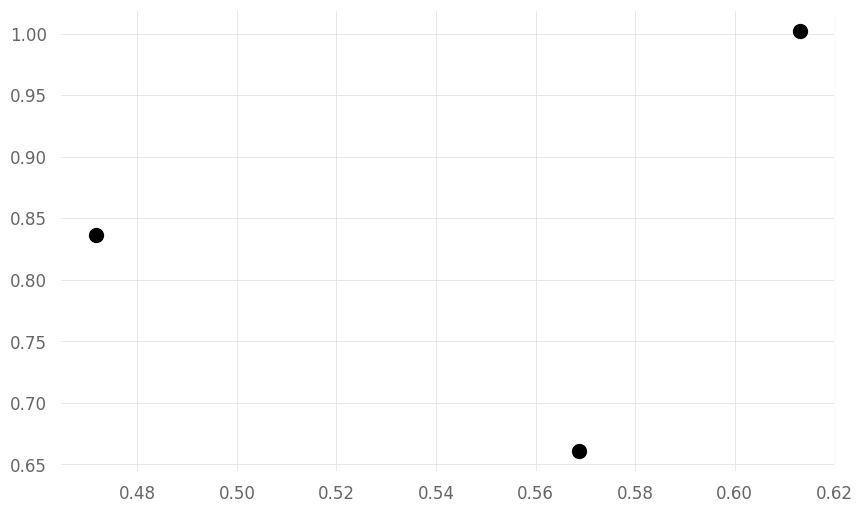

In [ ]:
try:
    sample_tickers = ['NVDA', 'AMD', 'TSLA', 'MSFT']
    sample_prices = train_data[train_data['Ticker'].isin(sample_tickers)]
    sample_prices_pivot = sample_prices.pivot(index='Date', columns='Ticker', values='close').dropna()

    mu_sample = expected_returns.mean_historical_return(sample_prices_pivot, compounding=True, frequency=252)
    S_sample = risk_models.CovarianceShrinkage(sample_prices_pivot, frequency=252).ledoit_wolf()

    ef_solve = EfficientFrontier(mu_sample, S_sample)
    ef_solve.max_sharpe()
    ret_tangent, std_tangent, _ = ef_solve.portfolio_performance()

    import matplotlib.pyplot as plt

    fig, ax = plt.subplots(figsize=(10, 6))

    for i, ticker in enumerate(sample_tickers):
        ax.scatter(
            np.sqrt(S_sample.iloc[i, i]),
            mu_sample[i],
            marker='o',
            s=100,
            color='black',
            label=ticker if i == 0 else ""
        )


    ax.scatter(
        std_tangent,
        ret_tangent,
        marker="*",
        s=300,
        c="red",
        label="Max Sharpe Portfolio"
    )

    ax.set_title("Risk vs. Return")
    ax.set_xlabel("Annualized Volatility (Risk)")
    ax.set_ylabel("Annualized Return")
    ax.legend()
    plt.grid(True)
    plt.show()

except Exception as e:
    print(f"ERROR: Could not plot Efficient Frontier. {e}")
    print("This is a non-critical demo plot. The main backtest is unaffected.")

In [ ]:
rebalance_dates = pd.date_range(start=BACKTEST_START_DATE, end=END_DATE, freq=REBALANCE_FREQUENCY)
all_test_days = pd.bdate_range(start=BACKTEST_START_DATE, end=END_DATE)

portfolio_returns = pd.Series(index=all_test_days, dtype=float)
weights_df = pd.DataFrame(index=all_test_days, columns=TICKER_UNIVERSE).fillna(0.0)
risk_dial_history = pd.Series(index=all_test_days, dtype=float)
cash_weight_history = pd.Series(index=all_test_days, dtype=float)
weights_df['Cash'] = 0.0

daily_returns_all = all_data_wide.xs('Close', level=1, axis=1).pct_change().loc[BACKTEST_START_DATE:]

current_weights = {}
rebalance_dates = rebalance_dates.to_list()
next_retrain_date = rebalance_dates[0]
alpha_model = None
scaler = None


def calculate_risk_score(credit_spread, vix, spy_ema_dist):
    """
    Calculates a risk score from 0.0 (Risk-On) to 1.0 (Risk-Off)
    using three factors: Volatility, Credit, and Trend.
    """
    vix_score = min(max(vix - 15, 0) / (40 - 15), 1.0)
    spread_score = min(max(credit_spread - 3.5, 0) / (6.0 - 3.5), 1.0)
    mom_score = min(max(0.02 - spy_ema_dist, 0) / (0.02 - (-0.05)), 1.0)

    risk_score = (vix_score + spread_score + mom_score) / 3
    return risk_score

for day in all_test_days:

    if len(rebalance_dates) > 0 and day >= rebalance_dates[0]:
        print(f"\n--- Rebalancing for {day.date()} ---")
        if day >= next_retrain_date:
            print(f"  > Re-training Alpha Model for {day.date()}...")

            train_start = day - relativedelta(years=TRAINING_WINDOW_YEARS)
            train_end = day - relativedelta(days=1)
            model_data = panel_data_features.dropna(subset=FEATURE_SET + ['label'])
            train_data = model_data[(model_data['Date'] >= train_start) & (model_data['Date'] <= train_end)]
            X_train = train_data[FEATURE_SET]
            y_train = train_data['label']
            qid_train = train_data['Date'].astype('category').cat.codes
            scaler = StandardScaler()
            X_train_scaled = scaler.fit_transform(X_train)
            alpha_model = xgb.XGBRanker(
                objective='rank:pairwise', eval_metric='ndcg@5',
                n_estimators=100, max_depth=3, learning_rate=0.1,
                random_state=42,
                scale_pos_weight=(y_train == 0).sum() / (y_train == 1).sum()
            )
            alpha_model.fit(X_train_scaled, y_train, qid=qid_train)
            next_retrain_date = day + relativedelta(months=RETRAIN_EVERY_MONTHS)
            print(f"  > Model re-trained. Next retrain on {next_retrain_date.date()}.")

        today_data_raw = panel_data_features.loc[panel_data_features['Date'] == day]
        today_data_tradeable = today_data_raw[today_data_raw['Ticker'].isin(TICKER_UNIVERSE)]
        today_data = today_data_tradeable.dropna(subset=FEATURE_SET).copy()

        if today_data.empty:
            print("  > Market closed or no valid data. Holding old weights.")
            if len(rebalance_dates) > 0: rebalance_dates.pop(0)
            continue
        try:
            spy_row = today_data_raw[today_data_raw['Ticker'] == BENCHMARK_TICKER].iloc[0]
        except IndexError:
            print(f"  > No SPY data for {day.date()}. Holding old weights.")
            if len(rebalance_dates) > 0: rebalance_dates.pop(0)
            continue

        vix = spy_row['VIX_Close']
        credit_spread = spy_row['Credit_Spread']
        spy_ema_dist = spy_row['EMA_DIST']

        risk_score = calculate_risk_score(credit_spread, vix, spy_ema_dist)
        portfolio_exposure = 1.0 - risk_score

        print(f"  > Risk Dial: VIX={vix:.2f}, Spread={credit_spread:.2f}, SPY_EMA_Dist={spy_ema_dist*100:.2f}% -> Risk Score={risk_score:.2f} -> Exposure={portfolio_exposure:.0%}")

        if portfolio_exposure == 0:
            print("  > REGIME FILTER: 100% CASH")
            current_weights = {}
            if len(rebalance_dates) > 0: rebalance_dates.pop(0)
            continue
        X_today = today_data[FEATURE_SET]
        X_today_scaled = scaler.transform(X_today)
        today_data['score'] = alpha_model.predict(X_today_scaled)

        top_k_tickers = today_data.sort_values(by='score', ascending=False).head(TOP_K_STOCKS)['Ticker'].tolist()
        print(f"  > Alpha Model Top {TOP_K_STOCKS} picks: {top_k_tickers}")

        one_year_ago = day - relativedelta(years=1)
        historical_prices = panel_data_features[
            (panel_data_features['Date'] < day) &
            (panel_data_features['Date'] >= one_year_ago) &
            (panel_data_features['Ticker'].isin(top_k_tickers))
        ]
        prices_df = historical_prices.pivot(index='Date', columns='Ticker', values='close').dropna()
        if prices_df.empty:
            print(f"  > Not enough historical data for optimizer. Defaulting to equal weights.")
            current_weights_target = {ticker: 1.0 / len(top_k_tickers) for ticker in top_k_tickers}
        else:
            scores_dict = today_data[today_data['Ticker'].isin(prices_df.columns)].set_index('Ticker')['score'].to_dict()
            current_weights_target = get_optimal_weights(prices_df, scores_dict)

        current_weights = {ticker: weight * portfolio_exposure for ticker, weight in current_weights_target.items()}
        cash_weight = 1.0 - sum(current_weights.values())
        current_weights['Cash'] = cash_weight

        print(f"  > Risk Model weights: {current_weights}")

        if len(rebalance_dates) > 0: rebalance_dates.pop(0)


    try:
        day_returns = daily_returns_all.loc[day]
        day_return = 0.0

        if not current_weights or ('Cash' in current_weights and current_weights['Cash'] == 1.0):
            day_return = 0.0
        else:
            for ticker, weight in current_weights.items():
                if ticker == 'Cash': continue
                if ticker in day_returns and pd.notna(day_returns[ticker]):
                    day_return += day_returns[ticker] * weight

        portfolio_returns[day] = day_return


        risk_dial_history[day] = risk_score
        cash_weight_history[day] = current_weights.get('Cash', 0.0)
        for ticker, weight in current_weights.items():
            if ticker != 'Cash':
                weights_df.loc[day, ticker] = weight

    except KeyError:
        portfolio_returns[day] = 0.0 # Market closed
    except Exception as e:
        print(f"Error on {day}: {e}")
        portfolio_returns[day] = 0.0

print("\n--- Backtest Complete ---")


--- Rebalancing for 2022-01-03 ---
  > Re-training Alpha Model for 2022-01-03...
  > Model re-trained. Next retrain on 2022-04-03.
  > Risk Dial: VIX=16.60, Spread=3.05, SPY_EMA_Dist=934.21% -> Risk Score=0.02 -> Exposure=98%
  > Alpha Model Top 5 picks: ['MSTR', 'XOM', 'PFE', 'BA', 'NVDA']
  > Risk Model weights: {'BA': np.float64(0.09786666615804036), 'MSTR': np.float64(0.19822893230311076), 'NVDA': np.float64(0.09786666615804036), 'PFE': np.float64(0.09786666615804036), 'XOM': np.float64(0.4868377308031718), 'Cash': np.float64(0.021333338419596393)}

--- Rebalancing for 2022-02-01 ---
  > Risk Dial: VIX=21.96, Spread=3.51, SPY_EMA_Dist=355.17% -> Risk Score=0.09 -> Exposure=91%
  > Alpha Model Top 5 picks: ['MSTR', 'NFLX', 'NVDA', 'PFE', 'TSLA']
  > Risk Model weights: {'MSTR': np.float64(0.0905866678873698), 'NFLX': np.float64(0.2876398465427653), 'NVDA': np.float64(0.0905866678873698), 'PFE': np.float64(0.3464668286688232), 'TSLA': np.float64(0.0905866678873698), 'Cash': np.float

In [ ]:
risk_df = pd.DataFrame({
    'Risk Score (0=On, 1=Off)': risk_dial_history,
    'Cash Weight': cash_weight_history,
    'SPY Close': all_data_wide[BENCHMARK_TICKER]['Close']
}).loc[BACKTEST_START_DATE:]

fig = make_subplots(
    rows=2,
    cols=1,
    shared_xaxes=True,
    vertical_spacing=0.03,
    subplot_titles=('Market (SPY) vs. Cash Weight', 'Risk Dial (0.0 = Risk-On, 1.0 = Risk-Off)'),
    specs=[[{"secondary_y": True}],   # Row 1 (Price vs. Cash %)
           [{"secondary_y": False}]]  # Row 2 (Risk Score)
)

fig.add_trace(go.Scatter(
    x=risk_df.index, y=risk_df['SPY Close'],
    name='SPY Close', line=dict(color='blue')
), row=1, col=1)

fig.add_trace(go.Scatter(
    x=risk_df.index, y=risk_df['Cash Weight'],
    name='Cash Weight', fill='tozeroy', line=dict(color='orange')
), row=1, col=1, secondary_y=True)
fig.add_trace(go.Scatter(
    x=risk_df.index, y=risk_df['Risk Score (0=On, 1=Off)'],
    name='Risk Score', fill='tozeroy', line=dict(color='red')
), row=2, col=1)

fig.update_layout(
    title='Risk Dial Performance',
    height=600,
    legend_title='Metric'
)
fig.update_yaxes(title_text='SPY Price', row=1, col=1, secondary_y=False)
fig.update_yaxes(title_text='Cash %', row=1, col=1, secondary_y=True, tickformat='.0%')
fig.update_yaxes(title_text='Risk Score', row=2, col=1)
fig.update_xaxes(title_text='Date', row=2, col=1)

fig.show()

In [ ]:
portfolio_returns = portfolio_returns.fillna(0.0)
cumulative_strategy = (1 + portfolio_returns).cumprod()

benchmark_returns_all = all_data_wide[BENCHMARK_TICKER]['Close'].pct_change()
benchmark_returns = benchmark_returns_all.reindex(cumulative_strategy.index).fillna(0.0)
cumulative_benchmark = (1 + benchmark_returns).cumprod()


fig = go.Figure()
fig.add_trace(go.Scatter(
    x=cumulative_strategy.index,
    y=cumulative_strategy,
    mode='lines',
    name='Level 2: Quant Portfolio'
))
fig.add_trace(go.Scatter(
    x=cumulative_benchmark.index,
    y=cumulative_benchmark,
    mode='lines',
    name=f'Benchmark ({BENCHMARK_TICKER})',
    line=dict(dash='dot')
))
fig.update_layout(
    title='Level 2 (Portfolio) vs. Benchmark (SPY)',
    yaxis_title='Cumulative Returns (Log Scale)',
    xaxis_title='Date',
    yaxis_type='log'
)
fig.show()

In [ ]:
weights_df_filled = weights_df.fillna(0.0)
fig = px.area(
    weights_df_filled,
    title='Portfolio Composition (Holdings Over Time)',
    labels={'value': 'Portfolio Weight', 'index': 'Date'}
)

fig.update_layout(
    yaxis_title='Portfolio Weight (%)',
    yaxis_tickformat='.0%' # Show as percentage
)
fig.show()

In [ ]:

fig = make_subplots(
    rows=2,
    cols=1,
    shared_xaxes=True,
    vertical_spacing=0.03,
    subplot_titles=('Stock Price', 'Portfolio Weight'),
    row_heights=[0.7, 0.3]
)

buttons = []
trace_count_per_ticker = 2

for i, ticker in enumerate(TICKER_UNIVERSE):
    stock_data = all_data_wide[ticker].loc[BACKTEST_START_DATE:]
    stock_weight = weights_df_filled[ticker]
    is_visible = (i == 0)
    fig.add_trace(go.Candlestick(
        x=stock_data.index,
        open=stock_data['Open'],
        high=stock_data['High'],
        low=stock_data['Low'],
        close=stock_data['Close'],
        name=f'{ticker} Price',
        visible=is_visible
    ), row=1, col=1)

    fig.add_trace(go.Scatter(
        x=stock_weight.index,
        y=stock_weight,
        name=f'{ticker} Weight',
        fill='tozeroy',
        line=dict(color='orange'),
        visible=is_visible
    ), row=2, col=1)

    visibility = [False] * (len(TICKER_UNIVERSE) * trace_count_per_ticker)
    for j in range(trace_count_per_ticker):
        visibility[i * trace_count_per_ticker + j] = True

    buttons.append(dict(
        label=ticker,
        method='update',
        args=[{'visible': visibility},
              {'title': f'{ticker} Trade Analysis (Price vs. Allocation)'}]
    ))


fig.update_layout(
    title_text=f'{TICKER_UNIVERSE[0]} Trade Analysis (Price vs. Allocation)',
    height=800,
    width=900,
    xaxis_rangeslider_visible=False,
    updatemenus=[dict(
        active=0,
        buttons=buttons,
        direction='down',
        pad={'r': 10, 't': 10},
        showactive=True,
        x=0.0,
        xanchor='left',
        y=1.1,
        yanchor='top'
    )],

    legend_orientation='h',
    legend_yanchor='bottom',
    legend_y=1.01
)

fig.update_yaxes(title_text='Price', row=1, col=1)
fig.update_yaxes(title_text='Portfolio Weight', row=2, col=1, tickformat='.0%')
fig.update_xaxes(title_text='Date', row=2, col=1)

fig.show()

In [ ]:
report_filename = 'level_2_report.html'
qs.reports.html(
    portfolio_returns,
    benchmark=benchmark_returns,
    title='Level 2 Cross-Sectional Model Report',
    output=report_filename
)

print(f"Report saved as {report_filename}")
print("\nKey Performance Metrics")

try:
    cagr = qs.stats.cagr(portfolio_returns)
    mdd = qs.stats.max_drawdown(portfolio_returns)
    sharpe = qs.stats.sharpe(portfolio_returns)
    sortino = qs.stats.sortino(portfolio_returns)
    calmar = qs.stats.calmar(portfolio_returns)

    print(f"Strategy CAGR: {cagr*100:.2f}%")
    print(f"Max Drawdown: {mdd*100:.2f}%")
    print(f"Sharpe Ratio: {sharpe:.2f}")
    print(f"Sortino Ratio: {sortino:.2f}")
    print(f"Calmar Ratio: {calmar:.2f}")

except Exception as e:
    print(f"Could not calculate all stats. Error: {e}")

print("\nLoading full HTML report...")
try:
    with open(report_filename, 'r', encoding='utf-8') as f:
        html_content = f.read()
    display(HTML(html_content))
except FileNotFoundError:
    print("ERROR: HTML file not found.")

Report saved as level_2_report.html

Key Performance Metrics
Strategy CAGR: 41.69%
Max Drawdown: -42.94%
Sharpe Ratio: 1.07
Sortino Ratio: 1.65
Calmar Ratio: 0.97

Loading full HTML report...


In [ ]:
# --- NEW CELL: MONTE CARLO STRESS-TESTING SETUP ---

import matplotlib.pyplot as plt
strategy_daily_returns = portfolio_returns.dropna()

N_SIMULATIONS = 5000
SIMULATION_DAYS = 252

sim_results = np.zeros((SIMULATION_DAYS + 1, N_SIMULATIONS))
sim_results[0, :] = 1.0

for i in range(N_SIMULATIONS):

    sim_returns = np.random.choice(
        strategy_daily_returns,
        SIMULATION_DAYS,
        replace=True
    )

    sim_results[1:, i] = (1 + sim_returns).cumprod()

print(f"Ran {N_SIMULATIONS} simulations of {SIMULATION_DAYS} days each.")


--- 17. RUNNING MONTE CARLO STRESS-TEST ---
Ran 5000 simulations of 252 days each.



--- 18. ANALYZING MONTE CARLO RESULTS ---
Plot saved as 'monte_carlo_spaghetti_L2.png'


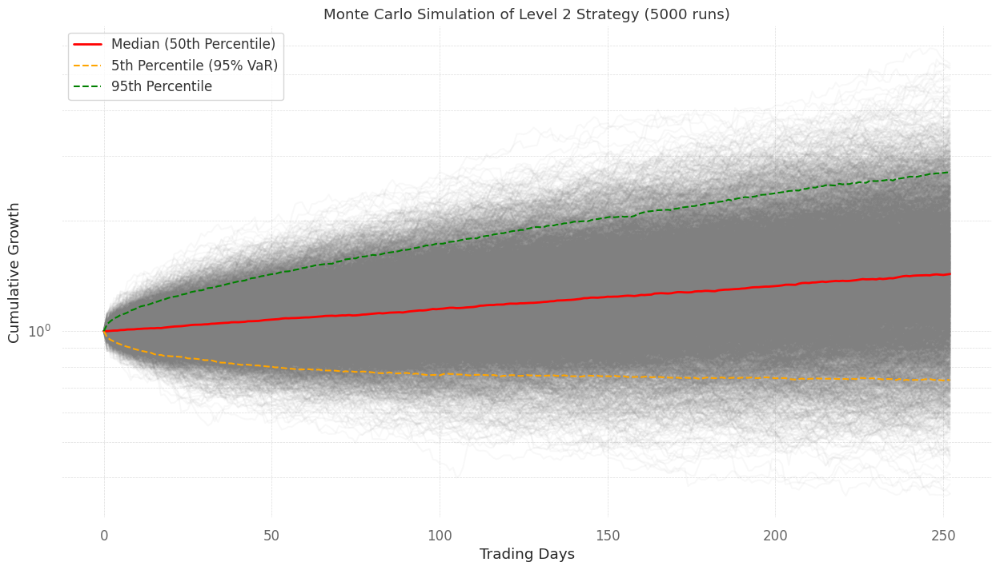

Plot saved as 'monte_carlo_distribution_L2.png'


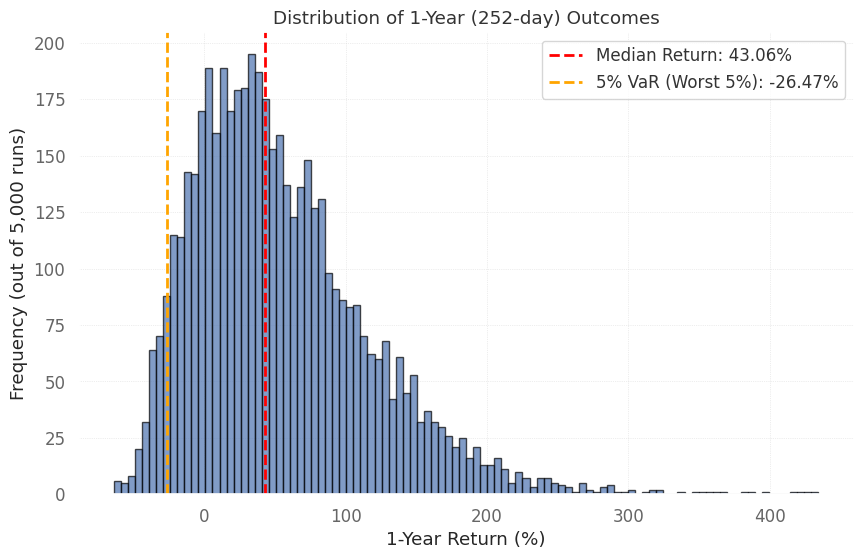


--- Monte Carlo 1-Year (252-day) Risk Metrics ---
Median 1-Year Growth: 1.43x (43.06%)
95th Percentile Growth: 2.71x
Worst 5% of outcomes (95% VaR): 0.74x (a loss of 26.47% or more)

--- END OF NOTEBOOK ---


In [ ]:
plt.figure(figsize=(15, 8))
plt.plot(sim_results, color='gray', alpha=0.05)
plt.plot(
    np.median(sim_results, axis=1),
    color='red',
    linewidth=2,
    label='Median (50th Percentile)'
)
plt.plot(
    np.percentile(sim_results, 5, axis=1),
    color='orange',
    linestyle='--',
    label='5th Percentile (95% VaR)'
)
plt.plot(
    np.percentile(sim_results, 95, axis=1),
    color='green',
    linestyle='--',
    label='95th Percentile'
)
plt.title(f'Monte Carlo Simulation of Level 2 Strategy ({N_SIMULATIONS} runs)')
plt.xlabel('Trading Days')
plt.ylabel('Cumulative Growth')
plt.yscale('log')
plt.legend(loc='upper left')
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.savefig('monte_carlo_spaghetti_L2.png')
print("Plot saved as 'monte_carlo_spaghetti_L2.png'")
plt.show()

final_outcomes = sim_results[-1, :]
final_outcomes_return = (final_outcomes - 1) * 100

plt.figure(figsize=(10, 6))
plt.hist(final_outcomes_return, bins=100, edgecolor='black', alpha=0.7)
plt.title('Distribution of 1-Year (252-day) Outcomes')
plt.xlabel('1-Year Return (%)')
plt.ylabel('Frequency (out of 5,000 runs)')
plt.axvline(
    np.median(final_outcomes_return),
    color='red',
    linestyle='--',
    linewidth=2,
    label=f"Median Return: {np.median(final_outcomes_return):.2f}%"
)
plt.axvline(
    np.percentile(final_outcomes_return, 5),
    color='orange',
    linestyle='--',
    linewidth=2,
    label=f"5% VaR (Worst 5%): {np.percentile(final_outcomes_return, 5):.2f}%"
)
plt.legend()
plt.grid(True, linestyle=':', linewidth=0.5)
plt.savefig('monte_carlo_distribution_L2.png')
print("Plot saved as 'monte_carlo_distribution_L2.png'")
plt.show()

print("\n--- Monte Carlo 1-Year (252-day) Risk Metrics ---")
median_return = np.median(final_outcomes)
var_5_percent = np.percentile(final_outcomes, 5)

print(f"Median 1-Year Growth: {median_return:.2f}x ({(median_return-1)*100:.2f}%)")
print(f"95th Percentile Growth: {np.percentile(final_outcomes, 95):.2f}x")
print(f"Worst 5% of outcomes (95% VaR): {var_5_percent:.2f}x (a loss of {(1-var_5_percent)*100:.2f}% or more)")